# Introduction

 
There are many competing views when it comes to explaining the success of a movie, but despite the large capital investment that must be made prior to movie production, the success, or profitability, of a movie, is largely uncertain.
In addition, different questions may arise: “How can a movie be defined as profitable?”, or “Does a specific genre leads to higher profits?”
 
I tried to explore the most important factors that would affect the profitability at an early stage of the movie production.
To achieve this goal, I used the “Boxofficemojo” dataset available at Kaggle: this dataset covers 2,476 US release movies from 2000 to March 2020 and it contains budgets, revenue data, and essential cast and crew info.
Before diving into my analysis, I would like to stress that my primary intention here is to only scratch the surface of this complex topic, offering insights and ideas for further developments.



# 1. Data Understanding

In [0]:
#importing main libraries that we use
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotnine import *

In [0]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [21]:
link = 'https://drive.google.com/open?id=1dPaPwp_EmbCj2LoPxQRTFYzdHk0z9VIY'
fluff, id = link.split('=')
print (id) # Verify that you have everything after '='

1dPaPwp_EmbCj2LoPxQRTFYzdHk0z9VIY


In [22]:
#importing Boxofficemojo dataset
downloaded = drive.CreateFile({'id':id}) 
downloaded.GetContentFile('Filename.csv')  
df = pd.read_csv('Filename.csv')
df.head()


,movie_id,movie_title,movie_year,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,budget,domestic,international,worldwide,mpaa,minutes,genre_1,genre_2,genre_3,genre_4,link
0,tt0168786,Antwone Fisher,2002,Denzel Washington,Antwone Fisher,Todd Black,Mychael Danna,Philippe Rousselot,Denzel Washington,Derek Luke,Joy Bryant,Malcolm David Kelley,12500000,21078145,2289441,23367586,PG-13,120.00,Biography,Drama,NaN,NaN,https://www.boxofficemojo.com/title/tt0168786/...
1,tt0179626,15 Minutes,2001,John Herzfeld,John Herzfeld,Keith Addis,Anthony Marinelli,Jean-Yves Escoffier,Robert De Niro,Edward Burns,Kelsey Grammer,Avery Brooks,60000000,24403552,31956428,56359980,R,120.00,Action,Crime,Drama,Thriller,https://www.boxofficemojo.com/title/tt0179626/...
2,tt0181984,Boiler Room,2000,Ben Younger,Ben Younger,Jennifer Todd,The Angel,Enrique Chediak,Giovanni Ribisi,Vin Diesel,Nia Long,Nicky Katt,7000000,16970581,11809674,28780255,R,120.00,Crime,Drama,Thriller,NaN,https://www.boxofficemojo.com/title/tt0181984/...
3,tt0190332,"Crouching Tiger, Hidden Dragon",2000,Ang Lee,Du Lu Wang,Li-Kong Hsu,Dun Tan,Peter Pau,Yun-Fat Chow,Michelle Yeoh,Ziyi Zhang,Chen Chang,17000000,128078872,85446864,213525736,PG-13,120.00,Action,Adventure,Fantasy,Romance,https://www.boxofficemojo.com/title/tt0190332/...
4,tt0198021,Where the Heart Is,2000,Matt Williams,Lowell Ganz,Susan Cartsonis,Mason Daring,Richard Greatrex,Natalie Portman,James Frain,Ashley Judd,Stockard Channing,15000000,33772838,7090880,40863718,PG-13,120.00,Comedy,Drama,Romance,NaN,https://www.boxofficemojo.com/title/tt0198021/...


In [23]:
df.shape

(2476, 23)

In [24]:
df.columns

Index(['movie_id', 'movie_title', 'movie_year', 'director', 'writer',
       'producer', 'composer', 'cinematographer', 'main_actor_1',
       'main_actor_2', 'main_actor_3', 'main_actor_4', 'budget', 'domestic',
       'international', 'worldwide', 'mpaa', 'minutes', 'genre_1', 'genre_2',
       'genre_3', 'genre_4', 'link'],
      dtype='object')

## 1.2 Data Profile

In [25]:
#create a complete profile of the dataset
from pandas_profiling import ProfileReport
ProfileReport(df, title='Pandas Profiling Report', html={'style':{'full_width':True}})

# 2. Data Exploration

## 2.1 Data Integration

### New Feature (ROI)

To represent the financial performance, I decided to adopt the Return on Investment (ROI) defined as:
 
(Gross - Budget) / Budget


In [26]:
#copy dataset
df_enr = df.copy() 

#calculating ROI (gross/revenue - 1)
df_enr['roi'] = df_enr['worldwide']/df_enr['budget']-1
df_enr['roi'].head()


df_enr.reset_index()
df_enr.head()

,movie_id,movie_title,movie_year,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,budget,domestic,international,worldwide,mpaa,minutes,genre_1,genre_2,genre_3,genre_4,link,roi
0,tt0168786,Antwone Fisher,2002,Denzel Washington,Antwone Fisher,Todd Black,Mychael Danna,Philippe Rousselot,Denzel Washington,Derek Luke,Joy Bryant,Malcolm David Kelley,12500000,21078145,2289441,23367586,PG-13,120.00,Biography,Drama,NaN,NaN,https://www.boxofficemojo.com/title/tt0168786/...,0.87
1,tt0179626,15 Minutes,2001,John Herzfeld,John Herzfeld,Keith Addis,Anthony Marinelli,Jean-Yves Escoffier,Robert De Niro,Edward Burns,Kelsey Grammer,Avery Brooks,60000000,24403552,31956428,56359980,R,120.00,Action,Crime,Drama,Thriller,https://www.boxofficemojo.com/title/tt0179626/...,-0.06
2,tt0181984,Boiler Room,2000,Ben Younger,Ben Younger,Jennifer Todd,The Angel,Enrique Chediak,Giovanni Ribisi,Vin Diesel,Nia Long,Nicky Katt,7000000,16970581,11809674,28780255,R,120.00,Crime,Drama,Thriller,NaN,https://www.boxofficemojo.com/title/tt0181984/...,3.11
3,tt0190332,"Crouching Tiger, Hidden Dragon",2000,Ang Lee,Du Lu Wang,Li-Kong Hsu,Dun Tan,Peter Pau,Yun-Fat Chow,Michelle Yeoh,Ziyi Zhang,Chen Chang,17000000,128078872,85446864,213525736,PG-13,120.00,Action,Adventure,Fantasy,Romance,https://www.boxofficemojo.com/title/tt0190332/...,11.56
4,tt0198021,Where the Heart Is,2000,Matt Williams,Lowell Ganz,Susan Cartsonis,Mason Daring,Richard Greatrex,Natalie Portman,James Frain,Ashley Judd,Stockard Channing,15000000,33772838,7090880,40863718,PG-13,120.00,Comedy,Drama,Romance,NaN,https://www.boxofficemojo.com/title/tt0198021/...,1.72


In [27]:
#check top 5 movies by ROI
df_enr.sort_values(by=['roi'],axis=0,ascending=False).head()

,movie_id,movie_title,movie_year,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,budget,domestic,international,worldwide,mpaa,minutes,genre_1,genre_2,genre_3,genre_4,link,roi
2354,tt1179904,Paranormal Activity,2007,Oren Peli,Oren Peli,Jason Blum,NaN,Oren Peli,Katie Featherston,Micah Sloat,Mark Fredrichs,Amber Armstrong,15000,107918810,85436990,193355800,R,86.00,Horror,Mystery,Thriller,NaN,https://www.boxofficemojo.com/title/tt1179904/...,12889.39
2264,tt0390538,Tarnation,2003,Jonathan Caouette,Jonathan Caouette,Jonathan Caouette,Max Avery Lichtenstein,Jonathan Caouette,Jonathan Caouette,Renee Leblanc,Adolph Davis,Rosemary Davis,220,592014,46507,638521,NaN,88.00,Biography,Documentary,NaN,NaN,https://www.boxofficemojo.com/title/tt0390538/...,2901.37
2451,tt2309260,The Gallows,2015,Travis Cluff,Chris Lofing,Jason Blum,Richard Breakspear,Edd Lukas,Reese Mishler,Pfeifer Brown,Ryan Shoos,Cassidy Gifford,100000,22764410,20200000,42964410,R,81.00,Horror,Mystery,Sci-Fi,Thriller,https://www.boxofficemojo.com/title/tt2309260/...,428.64
1583,tt0390521,Super Size Me,2004,Morgan Spurlock,Morgan Spurlock,Morgan Spurlock,Steve Horowitz,Scott Ambrozy,Morgan Spurlock,Daryl Isaacs,Chemeeka Walker,Dania Abu-Rmaileh,65000,11536423,9109334,20645757,PG,100.00,Comedy,Documentary,Drama,NaN,https://www.boxofficemojo.com/title/tt0390521/...,316.63
2159,tt0378407,My Date with Drew,2004,Jon Gunn,NaN,Kerry David,Stuart Hart,NaN,Brian Herzlinger,Drew Barrymore,John August,Stephanie Bedell Quartararo,1100,181041,81729,262770,PG,90.00,Documentary,NaN,NaN,NaN,https://www.boxofficemojo.com/title/tt0378407/...,237.88


In [0]:
#check numerical & categorical columns
numerical_cols = [col for col in df_enr.columns if df_enr[col].dtype != 'object']
categorical_cols = [col for col in df_enr.columns if df_enr[col].dtype == 'object']

In [29]:
#describe numerical columns
pd.options.display.float_format = "{:.2f}".format
df_enr[numerical_cols].describe()
#as expected the ROI show a significant SD (outliers)

,movie_year,budget,domestic,international,worldwide,minutes,roi
count,2476.00,2476.00,2476.00,2476.00,2476.00,2476.00,2476.00
mean,2008.87,50559230.34,66801131.86,88095564.92,154896696.78,108.98,9.70
std,5.63,49558579.75,82739849.60,150896048.89,225584908.02,18.10,265.78
min,2000.00,220.00,8000.00,999.00,79624.00,63.00,-0.99
25%,2004.00,16000000.00,16960482.00,7741621.75,29673562.25,96.00,0.16
50%,2009.00,35000000.00,39792109.00,33853085.00,76077613.50,106.00,1.33
75%,2014.00,69000000.00,83052279.00,97875821.50,180571457.50,119.00,3.18
max,2020.00,356000000.00,936662225.00,2029931375.00,2797800564.00,219.00,12889.39


In [30]:
#describe categorical columns
df_enr[categorical_cols].describe()

,movie_id,movie_title,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,mpaa,genre_1,genre_2,genre_3,genre_4,link
count,2476,2476,2476,2472,2471,2403,2386,2476,2476,2476,2476,2414,2476,2295,1730,903,2476
unique,2476,2465,1209,1645,1182,591,673,1010,1368,1660,1887,5,15,20,20,16,2476
top,tt0373469,Death at a Funeral,Clint Eastwood,Luc Besson,Jason Blum,Christophe Beck,Dean Semler,Mark Wahlberg,Samuel L. Jackson,Morgan Freeman,Amanda Peet,PG-13,Action,Drama,Thriller,Thriller,https://www.boxofficemojo.com/title/tt0938283/...
freq,1,2,16,11,34,59,25,21,12,11,7,1037,761,554,303,285,1


### Success / Flop Definition

A movie that makes a large gross profit is not necessarily a “profitable” movie. 
A general rule of thumb for qualifying a movie as a “financial success” is to compare its gross revenue to twice its reported budget 
- in other words, an ROI of at least 1. Therefore a label of “success” is assigned to a movie that attains ROI bigger than 1
label of “failure” means a movie’s ROI is less than 0 

In [0]:
#Define ROI labels 
def success(row):
  if row['roi'] <= 1:
    return 'Flop'
  elif row['roi'] > 1 :
    return 'Success'
  else:
    return 'flop'

df_enr['s/f'] = df_enr.apply(success, axis=1)

In [32]:
df_enr.head(5)

,movie_id,movie_title,movie_year,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,budget,domestic,international,worldwide,mpaa,minutes,genre_1,genre_2,genre_3,genre_4,link,roi,s/f
0,tt0168786,Antwone Fisher,2002,Denzel Washington,Antwone Fisher,Todd Black,Mychael Danna,Philippe Rousselot,Denzel Washington,Derek Luke,Joy Bryant,Malcolm David Kelley,12500000,21078145,2289441,23367586,PG-13,120.00,Biography,Drama,NaN,NaN,https://www.boxofficemojo.com/title/tt0168786/...,0.87,Flop
1,tt0179626,15 Minutes,2001,John Herzfeld,John Herzfeld,Keith Addis,Anthony Marinelli,Jean-Yves Escoffier,Robert De Niro,Edward Burns,Kelsey Grammer,Avery Brooks,60000000,24403552,31956428,56359980,R,120.00,Action,Crime,Drama,Thriller,https://www.boxofficemojo.com/title/tt0179626/...,-0.06,Flop
2,tt0181984,Boiler Room,2000,Ben Younger,Ben Younger,Jennifer Todd,The Angel,Enrique Chediak,Giovanni Ribisi,Vin Diesel,Nia Long,Nicky Katt,7000000,16970581,11809674,28780255,R,120.00,Crime,Drama,Thriller,NaN,https://www.boxofficemojo.com/title/tt0181984/...,3.11,Success
3,tt0190332,"Crouching Tiger, Hidden Dragon",2000,Ang Lee,Du Lu Wang,Li-Kong Hsu,Dun Tan,Peter Pau,Yun-Fat Chow,Michelle Yeoh,Ziyi Zhang,Chen Chang,17000000,128078872,85446864,213525736,PG-13,120.00,Action,Adventure,Fantasy,Romance,https://www.boxofficemojo.com/title/tt0190332/...,11.56,Success
4,tt0198021,Where the Heart Is,2000,Matt Williams,Lowell Ganz,Susan Cartsonis,Mason Daring,Richard Greatrex,Natalie Portman,James Frain,Ashley Judd,Stockard Channing,15000000,33772838,7090880,40863718,PG-13,120.00,Comedy,Drama,Romance,NaN,https://www.boxofficemojo.com/title/tt0198021/...,1.72,Success


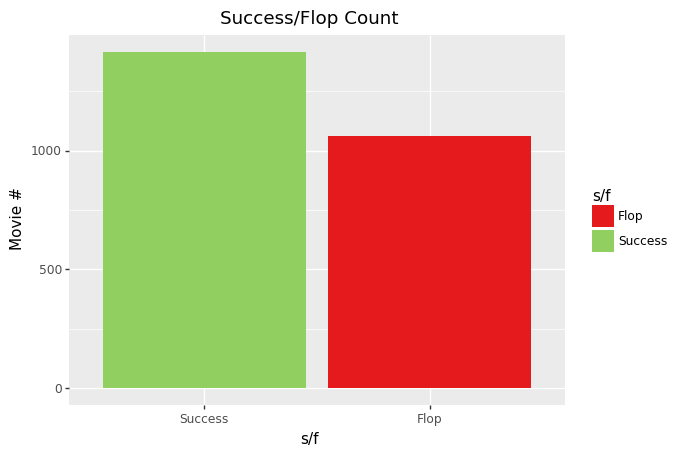

<ggplot: (-9223363271946259326)>

In [33]:
#visualize Success/Flop categories by count
success = (
ggplot(df_enr, aes(x='s/f', fill='s/f')) + 
    geom_bar() +
    scale_x_discrete(limits = ['Success','Flop']) +
    #scale_fill_brewer(type='diverging', palette='RdYlGn') +
    scale_fill_manual(values=('#e41a1c','#91cf60')) +
    ggtitle("Success/Flop Count") +
    #xlab("Success vs Flop") +
    ylab("Movie #") +
    theme_gray()
)

success

In [34]:
#count, percentage by s/f category
df_enr['s/f'].value_counts(normalize=True), df_enr['s/f'].value_counts() 


(Success   0.57
 Flop      0.43
 Name: s/f, dtype: float64, Success    1415
 Flop       1061
 Name: s/f, dtype: int64)

In [35]:
#count movie by category
df_enr['genre_1'].value_counts()

Action         761
Comedy         620
Drama          369
Adventure      256
Crime          144
Horror         141
Biography      139
Animation       20
Documentary     10
Fantasy          6
Mystery          4
Sci-Fi           2
Family           2
Music            1
Romance          1
Name: genre_1, dtype: int64

In [36]:
#count by success/flop, genre
df_enr.groupby(["s/f", "genre_1"])["genre_1"].count()

s/f      genre_1    
Flop     Action         342
         Adventure       83
         Animation        5
         Biography       68
         Comedy         271
         Crime           78
         Documentary      2
         Drama          182
         Family           1
         Fantasy          1
         Horror          25
         Music            1
         Mystery          1
         Sci-Fi           1
Success  Action         419
         Adventure      173
         Animation       15
         Biography       71
         Comedy         349
         Crime           66
         Documentary      8
         Drama          187
         Family           1
         Fantasy          5
         Horror         116
         Mystery          3
         Romance          1
         Sci-Fi           1
Name: genre_1, dtype: int64

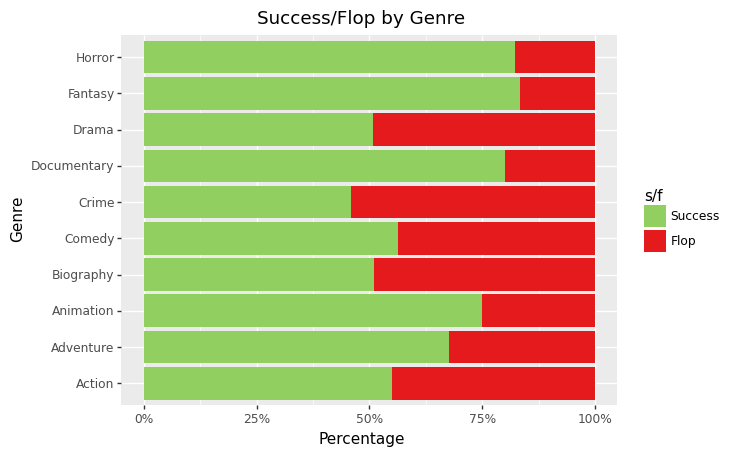

<ggplot: (8764912617536)>

In [37]:
#visualize genre categories by success/flop

#drop categories with < 3 entries
a = ['Sci-Fi','Romance','Family','Music','Mystery']

df_enr_f = df_enr[~df_enr['genre_1'].isin(a)]

genre = (
ggplot(df_enr_f, aes(fill='s/f', x='genre_1')) + 
    geom_bar(position="fill", stat="count") +
    scale_fill_manual(limits = ['Success','Flop'],\
                      values=('#91cf60','#e41a1c')) +
    ggtitle("Success/Flop by Genre") +
    xlab("Genre") +
    ylab("Percentage") +
    coord_flip() +
    theme_gray()
)

genre = genre + scale_y_continuous(labels=lambda l: ["%d%%" % (v * 100) for v in l])
genre


# Data Preparation

### 3.1 Missing Values

In [38]:
#copy dataset
df_cleaned = df_enr.copy() 
df_cleaned.isnull().sum().sort_values(ascending = False)

genre_4            1573
genre_3             746
genre_2             181
cinematographer      90
composer             73
mpaa                 62
producer              5
writer                4
s/f                   0
main_actor_2          0
movie_title           0
movie_year            0
director              0
main_actor_1          0
budget                0
main_actor_3          0
main_actor_4          0
roi                   0
domestic              0
international         0
worldwide             0
minutes               0
genre_1               0
link                  0
movie_id              0
dtype: int64

In [0]:
#Drop genre 2,3,4,link, movie_id columns
df_cleaned = df_cleaned.drop(['genre_2', 'genre_3', 'genre_4','link','movie_id'], axis=1)


In [0]:
numerical_cols = [col for col in df_cleaned.columns if df_cleaned[col].dtype != 'object']
categorical_cols = [col for col in df_cleaned.columns if df_cleaned[col].dtype == 'object']

In [41]:
#check numerical & categorical cols
numerical_cols, categorical_cols

(['movie_year',
  'budget',
  'domestic',
  'international',
  'worldwide',
  'minutes',
  'roi'],
 ['movie_title',
  'director',
  'writer',
  'producer',
  'composer',
  'cinematographer',
  'main_actor_1',
  'main_actor_2',
  'main_actor_3',
  'main_actor_4',
  'mpaa',
  'genre_1',
  's/f'])

In [42]:
#describe numerical columns
pd.options.display.float_format = "{:.2f}".format
df_cleaned[numerical_cols].describe()

,movie_year,budget,domestic,international,worldwide,minutes,roi
count,2476.00,2476.00,2476.00,2476.00,2476.00,2476.00,2476.00
mean,2008.87,50559230.34,66801131.86,88095564.92,154896696.78,108.98,9.70
std,5.63,49558579.75,82739849.60,150896048.89,225584908.02,18.10,265.78
min,2000.00,220.00,8000.00,999.00,79624.00,63.00,-0.99
25%,2004.00,16000000.00,16960482.00,7741621.75,29673562.25,96.00,0.16
50%,2009.00,35000000.00,39792109.00,33853085.00,76077613.50,106.00,1.33
75%,2014.00,69000000.00,83052279.00,97875821.50,180571457.50,119.00,3.18
max,2020.00,356000000.00,936662225.00,2029931375.00,2797800564.00,219.00,12889.39


In [43]:
#describe categorical columns
df_enr[categorical_cols].describe()

,movie_title,director,writer,producer,composer,cinematographer,main_actor_1,main_actor_2,main_actor_3,main_actor_4,mpaa,genre_1,s/f
count,2476,2476,2472,2471,2403,2386,2476,2476,2476,2476,2414,2476,2476
unique,2465,1209,1645,1182,591,673,1010,1368,1660,1887,5,15,2
top,Death at a Funeral,Clint Eastwood,Luc Besson,Jason Blum,Christophe Beck,Dean Semler,Mark Wahlberg,Samuel L. Jackson,Morgan Freeman,Amanda Peet,PG-13,Action,Success
freq,2,16,11,34,59,25,21,12,11,7,1037,761,1415


In [44]:
df_cleaned.shape

(2476, 20)

In [45]:
#check % of missing values
df_cleaned.isnull().mean().sort_values(ascending = False), df_cleaned.isnull().sum().sort_values(ascending = False)

(cinematographer   0.04
 composer          0.03
 mpaa              0.03
 producer          0.00
 writer            0.00
 s/f               0.00
 main_actor_2      0.00
 movie_year        0.00
 director          0.00
 main_actor_1      0.00
 main_actor_3      0.00
 roi               0.00
 main_actor_4      0.00
 budget            0.00
 domestic          0.00
 international     0.00
 worldwide         0.00
 minutes           0.00
 genre_1           0.00
 movie_title       0.00
 dtype: float64, cinematographer    90
 composer           73
 mpaa               62
 producer            5
 writer              4
 s/f                 0
 main_actor_2        0
 movie_year          0
 director            0
 main_actor_1        0
 main_actor_3        0
 roi                 0
 main_actor_4        0
 budget              0
 domestic            0
 international       0
 worldwide           0
 minutes             0
 genre_1             0
 movie_title         0
 dtype: int64)

In [0]:
#drop rows < 5% of missing values
df_cleaned = df_cleaned.dropna(axis=0,subset=['cinematographer','composer','mpaa','producer','writer'], how='any') #axis 0 specifies you drop, how all specifies that you 


In [47]:
df_cleaned.isnull().sum().sort_values(ascending = False), df_enr.shape

(s/f                0
 roi                0
 movie_year         0
 director           0
 writer             0
 producer           0
 composer           0
 cinematographer    0
 main_actor_1       0
 main_actor_2       0
 main_actor_3       0
 main_actor_4       0
 budget             0
 domestic           0
 international      0
 worldwide          0
 mpaa               0
 minutes            0
 genre_1            0
 movie_title        0
 dtype: int64, (2476, 25))

### 3.2 Outliers

The IQR, also called the midspread, is a measure of statistical dispersion 
and can be used to get identify and remove outliers. 
In this case I used this measure to reduce the spread in the ROI


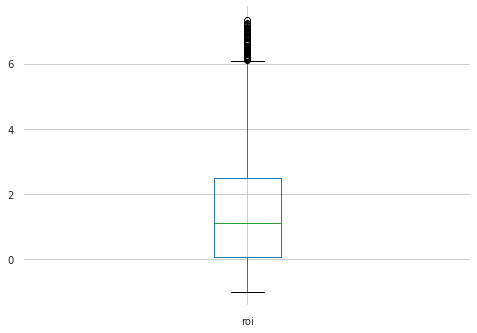

In [48]:
Q1 = df_cleaned['roi'].quantile(0.25)
Q3 = df_cleaned['roi'].quantile(0.75)
IQR = Q3 - Q1
# Filtering Values between Q1-1.5IQR and Q3+1.5IQR
df_cleaned = df_cleaned.query('(@Q1 - 1.5 * @IQR) <= roi <= (@Q3 + 1.5 * @IQR)')
df_cleaned.boxplot('roi')

In [49]:
df_cleaned[numerical_cols].describe()

,movie_year,budget,domestic,international,worldwide,minutes,roi
count,2092.00,2092.00,2092.00,2092.00,2092.00,2092.00,2092.00
mean,2008.70,52969550.67,61604042.22,79981010.23,141585052.45,109.70,1.50
std,5.60,49928229.43,75092895.30,137247304.40,205305647.65,17.26,1.82
min,2000.00,200000.00,8000.00,999.00,79624.00,73.00,-0.99
25%,2004.00,19800000.00,16135209.50,6951271.50,27641925.00,97.00,0.08
50%,2009.00,35000000.00,37468062.00,29796997.00,69727724.00,107.00,1.11
75%,2013.00,70000000.00,76048165.00,87607463.50,167824819.75,120.00,2.49
max,2020.00,356000000.00,858373000.00,1939427564.00,2797800564.00,219.00,7.34


In [50]:
df_cleaned.shape

(2092, 20)

### 3.3 Data Wrangling


Dealing with variables with high cadinality, transforming them in value counts variables.
Dealing with categorical variables, using one hot encoding

In [51]:
#writer: high cardinality - create a new column based on count
writer_value_counts = df_cleaned.writer.value_counts()
writer_value_counts = pd.DataFrame(writer_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'writer', 'writer' : 'writer_value_counts'})
writer_value_counts.head()

,writer,writer_value_counts
0,Ehren Kruger,8
1,Sean Anders,7
2,Robert Rodriguez,7
3,Luc Besson,7
4,M. Night Shyamalan,6


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, writer_value_counts,left_on = 'writer', right_on = 'writer', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'writer')

In [53]:
#director: high cardinality - create a new column based on count
director_value_counts = df_cleaned.director.value_counts()
director_value_counts = pd.DataFrame(director_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'director', 'director' : 'director_value_counts'})
director_value_counts.head()

,director,director_value_counts
0,Clint Eastwood,14
1,Ridley Scott,13
2,Steven Spielberg,13
3,Michael Bay,10
4,Ron Howard,10


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, director_value_counts,left_on = 'director', right_on = 'director', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'director')

In [55]:
#main actor: high cardinality - create a new column based on count
main_actor_1_value_counts = df_cleaned.main_actor_1.value_counts()
main_actor_1_value_counts = pd.DataFrame(main_actor_1_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'main_actor_1', 'main_actor_1' : 'main_actor_1_value_counts'})
main_actor_1_value_counts.head()

,main_actor_1,main_actor_1_value_counts
0,Mark Wahlberg,20
1,Denzel Washington,20
2,Tom Cruise,18
3,Johnny Depp,18
4,Adam Sandler,18


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, main_actor_1_value_counts,left_on = 'main_actor_1', right_on = 'main_actor_1', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'main_actor_1')

In [57]:
#main_actor_2: high cardinality - create a new column based on count
main_actor_2_value_counts = df_cleaned.main_actor_2.value_counts()
main_actor_2_value_counts = pd.DataFrame(main_actor_2_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'main_actor_2', 'main_actor_2' : 'main_actor_2_value_counts'})
main_actor_2_value_counts.head()

,main_actor_2,main_actor_2_value_counts
0,Samuel L. Jackson,11
1,Penélope Cruz,10
2,Owen Wilson,10
3,Elizabeth Banks,9
4,Aaron Eckhart,9


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, main_actor_2_value_counts,left_on = 'main_actor_2', right_on = 'main_actor_2', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'main_actor_2')

In [59]:
#main actor_3: high cardinality - create a new column based on count
main_actor_3_value_counts = df_cleaned.main_actor_3.value_counts()
main_actor_3_value_counts = pd.DataFrame(main_actor_3_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'main_actor_3', 'main_actor_3' : 'main_actor_3_value_counts'})

main_actor_3_value_counts.head()

,main_actor_3,main_actor_3_value_counts
0,Morgan Freeman,11
1,Scarlett Johansson,7
2,Olivia Wilde,7
3,Tom Wilkinson,6
4,John Goodman,6


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, main_actor_3_value_counts,left_on = 'main_actor_3', right_on = 'main_actor_3', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'main_actor_3')

In [61]:
#main_actor_4: high cardinality - create a new column based on count
main_actor_4_value_counts = df_cleaned.main_actor_4.value_counts()
main_actor_4_value_counts = pd.DataFrame(main_actor_4_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'main_actor_4', 'main_actor_4' : 'main_actor_4_value_counts'})
main_actor_4_value_counts.head()

,main_actor_4,main_actor_4_value_counts
0,Amanda Peet,7
1,Ciarán Hinds,6
2,Michael Caine,6
3,Stanley Tucci,5
4,Emily Mortimer,5


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, main_actor_4_value_counts,left_on = 'main_actor_4', right_on = 'main_actor_4', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'main_actor_4')

In [63]:
#producer: high cardinality - create a new column based on count
producer_value_counts = df_cleaned.producer.value_counts()
producer_value_counts = pd.DataFrame(producer_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'producer', 'producer' : 'producer_value_counts'})
producer_value_counts.head()

,producer,producer_value_counts
0,Tim Bevan,26
1,Jerry Bruckheimer,20
2,Lorenzo di Bonaventura,19
3,Todd Black,17
4,Brian Grazer,16


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, producer_value_counts,left_on = 'producer', right_on = 'producer', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'producer')

In [65]:
#composer: high cardinality - create a new column based on count
composer_value_counts = df_cleaned.composer.value_counts()
composer_value_counts = pd.DataFrame(composer_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'composer', 'composer' : 'composer_value_counts'})

composer_value_counts.head()

,composer,composer_value_counts
0,Christophe Beck,58
1,James Newton Howard,51
2,John Debney,46
3,Marco Beltrami,45
4,Danny Elfman,37


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, composer_value_counts,left_on = 'composer', right_on = 'composer', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'composer')

In [67]:
#cinematographer: high cardinality - create a new column based on count
cinematographer_value_counts = df_cleaned.cinematographer.value_counts()
cinematographer_value_counts = pd.DataFrame(cinematographer_value_counts).reset_index().\
                                                        rename(columns = {'index' : 'cinematographer', 'cinematographer' : 'cinematographer_value_counts'})

cinematographer_value_counts.head()

,cinematographer,cinematographer_value_counts
0,Dean Semler,24
1,Robert Elswit,20
2,Roger Deakins,20
3,Don Burgess,20
4,Oliver Wood,19


In [0]:
#join new column / drop old column
df_cleaned = pd.merge(df_cleaned, cinematographer_value_counts,left_on = 'cinematographer', right_on = 'cinematographer', how = 'left')

df_cleaned = df_cleaned.drop(columns = 'cinematographer')

In [0]:
#define a function to creare dummy variables for cat features 
def create_dummy_df(df, cat_cols, dummy_na):
    
    for col in cat_cols:
            # for each cat add dummy var, drop original column
            df = pd.concat([df.drop(col, axis=1), pd.get_dummies(df[col], prefix=col, prefix_sep='_', drop_first=True, dummy_na=dummy_na)], axis=1)
    return df

In [70]:
#create dummy variables for genre and mpaa
cat_cols_lst = ['genre_1', 'mpaa']

df_cleaned = create_dummy_df(df_cleaned, cat_cols_lst, dummy_na=False) 
df_cleaned

,movie_title,movie_year,budget,domestic,international,worldwide,minutes,roi,s/f,writer_value_counts,director_value_counts,main_actor_1_value_counts,main_actor_2_value_counts,main_actor_3_value_counts,main_actor_4_value_counts,producer_value_counts,composer_value_counts,cinematographer_value_counts,genre_1_Adventure,genre_1_Animation,genre_1_Biography,genre_1_Comedy,genre_1_Crime,genre_1_Documentary,genre_1_Drama,genre_1_Family,genre_1_Fantasy,genre_1_Horror,genre_1_Mystery,genre_1_Romance,genre_1_Sci-Fi,mpaa_NC-17,mpaa_PG,mpaa_PG-13,mpaa_R
0,Antwone Fisher,2002,12500000,21078145,2289441,23367586,120.00,0.87,Flop,1,2,20,2,2,1,17,16,14,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,15 Minutes,2001,60000000,24403552,31956428,56359980,120.00,-0.06,Flop,1,1,16,2,4,1,1,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,Boiler Room,2000,7000000,16970581,11809674,28780255,120.00,3.11,Success,3,3,1,2,2,2,3,1,12,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
3,Where the Heart Is,2000,15000000,33772838,7090880,40863718,120.00,1.72,Success,3,1,4,1,2,1,5,2,5,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
4,K-PAX,2001,68000000,50338485,14663000,65001485,120.00,-0.04,Flop,1,3,6,4,3,2,1,24,13,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2087,9,2009,30000000,31749894,16678169,48428063,79.00,0.61,Flop,1,1,2,5,1,5,4,8,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2088,Stuart Little 2,2002,120000000,64956806,105000000,169956806,77.00,0.42,Flop,1,2,1,1,3,1,9,27,5,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2089,Valiant,2005,35000000,19478106,42268782,61746888,76.00,0.76,Flop,1,1,7,1,1,5,1,10,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2090,The Powerpuff Girls Movie,2002,11000000,11412414,5014057,16426471,73.00,0.49,Flop,1,1,1,1,1,1,1,10,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [71]:
df_cleaned.head().T

,0,1,2,3,4
movie_title,Antwone Fisher,15 Minutes,Boiler Room,Where the Heart Is,K-PAX
movie_year,2002,2001,2000,2000,2001
budget,12500000,60000000,7000000,15000000,68000000
domestic,21078145,24403552,16970581,33772838,50338485
international,2289441,31956428,11809674,7090880,14663000
worldwide,23367586,56359980,28780255,40863718,65001485
minutes,120.00,120.00,120.00,120.00,120.00
roi,0.87,-0.06,3.11,1.72,-0.04
s/f,Flop,Flop,Success,Success,Flop
writer_value_counts,1,1,3,3,1


### 3.4 Data Profile After Preparation

In [72]:
#create a complete profile of the dataset
ProfileReport(df_cleaned, title='Profiling Report After Preparation', html={'style':{'full_width':True}})


# Data Modeling: Classification

In [0]:
#keep our original dataset for reference. 
datasetC = df_cleaned.copy() #Here datasetC is for classification model

In [0]:
#datasetC drop roi,domestic,international,worldwide columns
datasetC = datasetC.drop(columns = ['movie_title','roi','domestic','international','worldwide'])

In [75]:
datasetC.head()

,movie_year,budget,minutes,s/f,writer_value_counts,director_value_counts,main_actor_1_value_counts,main_actor_2_value_counts,main_actor_3_value_counts,main_actor_4_value_counts,producer_value_counts,composer_value_counts,cinematographer_value_counts,genre_1_Adventure,genre_1_Animation,genre_1_Biography,genre_1_Comedy,genre_1_Crime,genre_1_Documentary,genre_1_Drama,genre_1_Family,genre_1_Fantasy,genre_1_Horror,genre_1_Mystery,genre_1_Romance,genre_1_Sci-Fi,mpaa_NC-17,mpaa_PG,mpaa_PG-13,mpaa_R
0,2002,12500000,120.00,Flop,1,2,20,2,2,1,17,16,14,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,2001,60000000,120.00,Flop,1,1,16,2,4,1,1,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,2000,7000000,120.00,Success,3,3,1,2,2,2,3,1,12,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
3,2000,15000000,120.00,Success,3,1,4,1,2,1,5,2,5,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
4,2001,68000000,120.00,Flop,1,3,6,4,3,2,1,24,13,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0


## 4.1 Test and Train Split


In [0]:
#split the dataset: train & test
from sklearn.model_selection import train_test_split
y = datasetC.pop('s/f')
X = datasetC
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, test_size = 0.2, random_state = 42)

In [77]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((1673, 29), (1673,), (419, 29), (419,))

In [78]:
X_train.shape

(1673, 29)

## 4.2 Feature Elimination

We dont want our model to feed with all the variables which might mot help in prediction. We do remove variables having High Collinearity and use only variables useful for our model by doing the Recursive Feature Elimination.

In [0]:
#removing variables with high colinearity
def correlation(dataset, threshold):
    col_corr = set() # Set of all the names of deleted columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i] # getting the name of column
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] # deleting the column from the dataset
correlation(X_train,0.90)

In [80]:
X_train.shape, y_train.shape

((1673, 29), (1673,))

## 5.1 Dealing with Unbalanced Data

Since the dependent variable follow roughly a 60/40 distribution, I decided to not apply any resampling techniques

## 5.2 Decision Tree Model

In [0]:
#importing the required libraries
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier

# Create Decision Tree classifer object
clf = DecisionTreeClassifier(criterion='gini' , max_depth=3)

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

In [0]:
#Predict the response for test dataset
rfe = RFE(clf, 29)            # running RFE
rfe = rfe.fit(X_train, y_train)

In [83]:
list(zip(X_train.columns,rfe.support_,rfe.ranking_))

[('movie_year', True, 1),
 ('budget', True, 1),
 ('minutes', True, 1),
 ('writer_value_counts', True, 1),
 ('director_value_counts', True, 1),
 ('main_actor_1_value_counts', True, 1),
 ('main_actor_2_value_counts', True, 1),
 ('main_actor_3_value_counts', True, 1),
 ('main_actor_4_value_counts', True, 1),
 ('producer_value_counts', True, 1),
 ('composer_value_counts', True, 1),
 ('cinematographer_value_counts', True, 1),
 ('genre_1_Adventure', True, 1),
 ('genre_1_Animation', True, 1),
 ('genre_1_Biography', True, 1),
 ('genre_1_Comedy', True, 1),
 ('genre_1_Crime', True, 1),
 ('genre_1_Documentary', True, 1),
 ('genre_1_Drama', True, 1),
 ('genre_1_Family', True, 1),
 ('genre_1_Fantasy', True, 1),
 ('genre_1_Horror', True, 1),
 ('genre_1_Mystery', True, 1),
 ('genre_1_Romance', True, 1),
 ('genre_1_Sci-Fi', True, 1),
 ('mpaa_NC-17', True, 1),
 ('mpaa_PG', True, 1),
 ('mpaa_PG-13', True, 1),
 ('mpaa_R', True, 1)]

In [84]:
col_rfe = X_train.columns[rfe.support_]
col_rfe

Index(['movie_year', 'budget', 'minutes', 'writer_value_counts',
       'director_value_counts', 'main_actor_1_value_counts',
       'main_actor_2_value_counts', 'main_actor_3_value_counts',
       'main_actor_4_value_counts', 'producer_value_counts',
       'composer_value_counts', 'cinematographer_value_counts',
       'genre_1_Adventure', 'genre_1_Animation', 'genre_1_Biography',
       'genre_1_Comedy', 'genre_1_Crime', 'genre_1_Documentary',
       'genre_1_Drama', 'genre_1_Family', 'genre_1_Fantasy', 'genre_1_Horror',
       'genre_1_Mystery', 'genre_1_Romance', 'genre_1_Sci-Fi', 'mpaa_NC-17',
       'mpaa_PG', 'mpaa_PG-13', 'mpaa_R'],
      dtype='object')

In [85]:
X_train.columns[~rfe.support_]

Index([], dtype='object')

In [0]:
#Creating a X_train dataframe with rfe variables
X_train_rfe = X_train[col_rfe]
X_test_rfe = X_test[col_rfe]

In [0]:
y_dt_pred = clf.predict(X_test_rfe)

In [88]:
#create metrics to evaluate the model
from sklearn import metrics
count_misclassified = (y_test != y_dt_pred).sum()
print('Misclassified samples: {}'.format(count_misclassified))
accuracy = metrics.accuracy_score(y_test, y_dt_pred)
print('Accuracy: {:.2f}'.format(accuracy))
precision = metrics.precision_score(y_test, y_dt_pred, average= 'macro')
print('Precision: {:.2f}'.format(precision))
recall = metrics.recall_score(y_test, y_dt_pred, average= 'macro')
print('Recall: {:.2f}'.format(recall))
f1_score = metrics.f1_score(y_test, y_dt_pred, average = 'macro')
print('F1 score: {:.2f}'.format(f1_score))

Misclassified samples: 161
Accuracy: 0.62
Precision: 0.61
Recall: 0.61
F1 score: 0.60


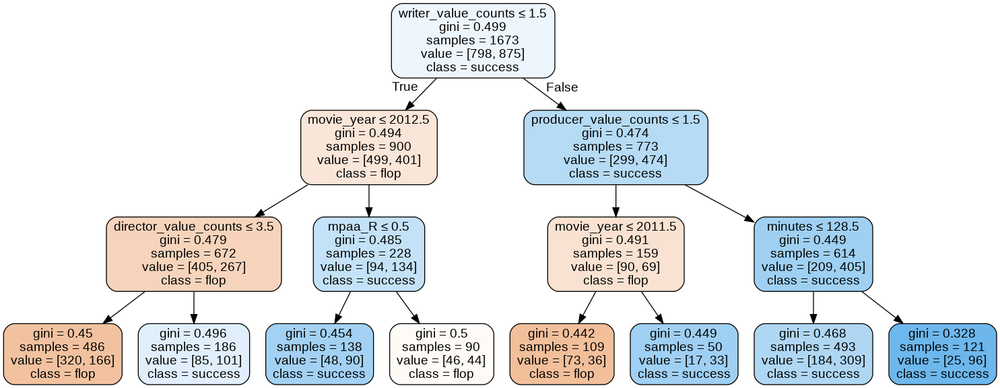

In [89]:
#create a viz of the decision tree
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = col_rfe,class_names=['flop','success'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('movie success.png')
Image(graph.create_png())


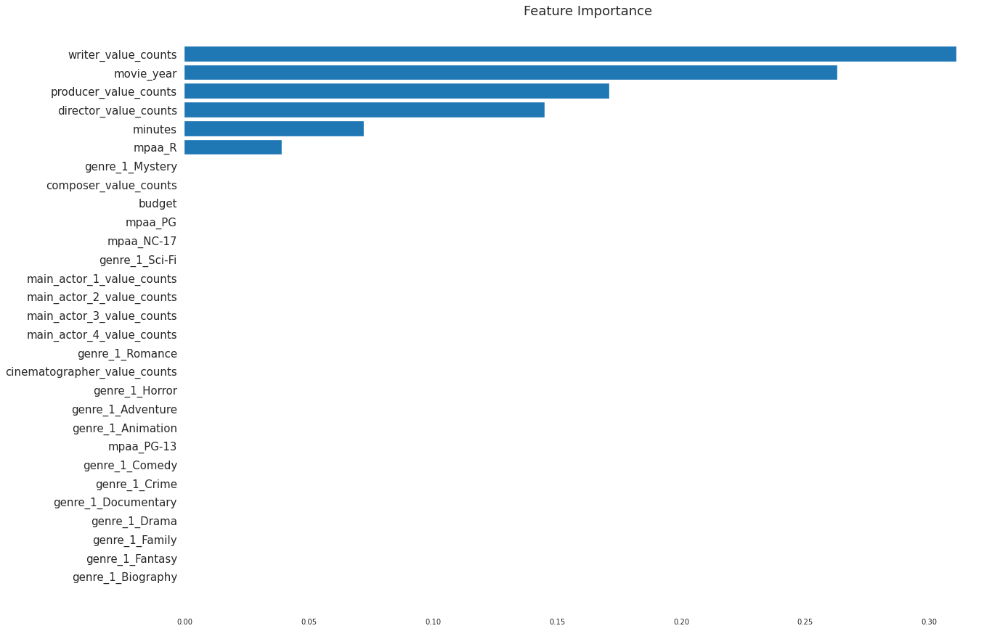

In [90]:
#viz feature importance
feature_importance = np.round(clf.feature_importances_,3)
sorted_importance = np.argsort(feature_importance)
pos = np.arange(len(sorted_importance))
plt.figure(figsize=(20,15))
plt.barh(pos, feature_importance[sorted_importance],align='center')
plt.yticks(pos, X_train_rfe.columns[sorted_importance],fontsize=15)
plt.title('Feature Importance ',fontsize=18)
plt.show()

In [91]:
importances = pd.DataFrame({'feature':X_train.columns,'importance':np.round(clf.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False)
subset = importances[importances['importance'] > 0]
subset

,feature,importance
3,writer_value_counts,0.31
0,movie_year,0.26
9,producer_value_counts,0.17
4,director_value_counts,0.14
2,minutes,0.07
28,mpaa_R,0.04


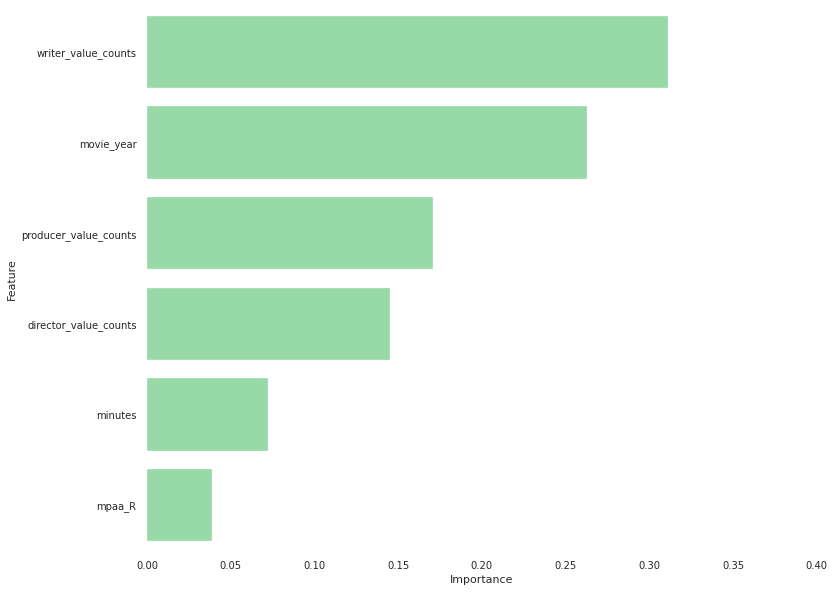

In [92]:
#create a nicer viz
f, ax = plt.subplots(figsize=(12, 10))
sns.set_color_codes("pastel")
sns.barplot(x='importance', y="feature", data=subset, color='g')
# Add a legend and informative axis label
ax.set(xlim=(0, 0.4), ylabel="Feature",
       xlabel="Importance")
sns.despine(left=True, bottom=True)


## 5.3 XGBoost

In [0]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
param_grid = {
     'objective' : ['binary:logistic'],
     'n_estimators': [100, 500, 1000],
     'random_state': [0]
}
# Create a based model
xgb_model_classification = XGBClassifier()
# Instantiate the grid search model
grid_search_xgb_model_classificaiton = GridSearchCV(estimator = xgb_model_classification, param_grid = param_grid, 
                          cv = 3, n_jobs = -1, verbose = 2)

In [94]:
grid_search_xgb_model_classificaiton.fit(X_train_rfe, y_train)

Fitting 3 folds for each of 3 candidates, totalling 9 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 out of   9 | elapsed:    4.9s finished


GridSearchCV(cv=3, error_score=nan,
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.1, max_delta_step=0,
                                     max_depth=3, min_child_weight=1,
                                     missing=None, n_estimators=100, n_jobs=1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=0, reg_alpha=0, reg_lambda=1,
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='deprecated', n_jobs=-1,
             param_grid={'n_estimators': [100, 500, 1000],
                         'objective': ['binary:logistic'],
                         'random_state': [0]},
             p

In [0]:
y_xgb_classification_pred = grid_search_xgb_model_classificaiton.predict(X_test_rfe)

In [96]:
y_xgb_classification_pred[:20]

array(['Success', 'Success', 'Success', 'Flop', 'Flop', 'Success',
       'Success', 'Flop', 'Flop', 'Flop', 'Flop', 'Success', 'Flop',
       'Success', 'Flop', 'Success', 'Flop', 'Flop', 'Success', 'Success'],
      dtype=object)

In [97]:
#create metrics to evaluate the model
from sklearn import metrics
count_misclassified = (y_test != y_xgb_classification_pred).sum()
print('Misclassified samples: {}'.format(count_misclassified))
accuracy = metrics.accuracy_score(y_test, y_xgb_classification_pred)
print('Accuracy: {:.2f}'.format(accuracy))
precision = metrics.precision_score(y_test, y_xgb_classification_pred, average= 'macro')
print('Precision: {:.2f}'.format(precision))
recall = metrics.recall_score(y_test, y_xgb_classification_pred, average= 'macro')
print('Recall: {:.2f}'.format(recall))
f1_score = metrics.f1_score(y_test, y_xgb_classification_pred, average = 'macro')
print('F1 score: {:.2f}'.format(f1_score))

Misclassified samples: 149
Accuracy: 0.64
Precision: 0.64
Recall: 0.64
F1 score: 0.64


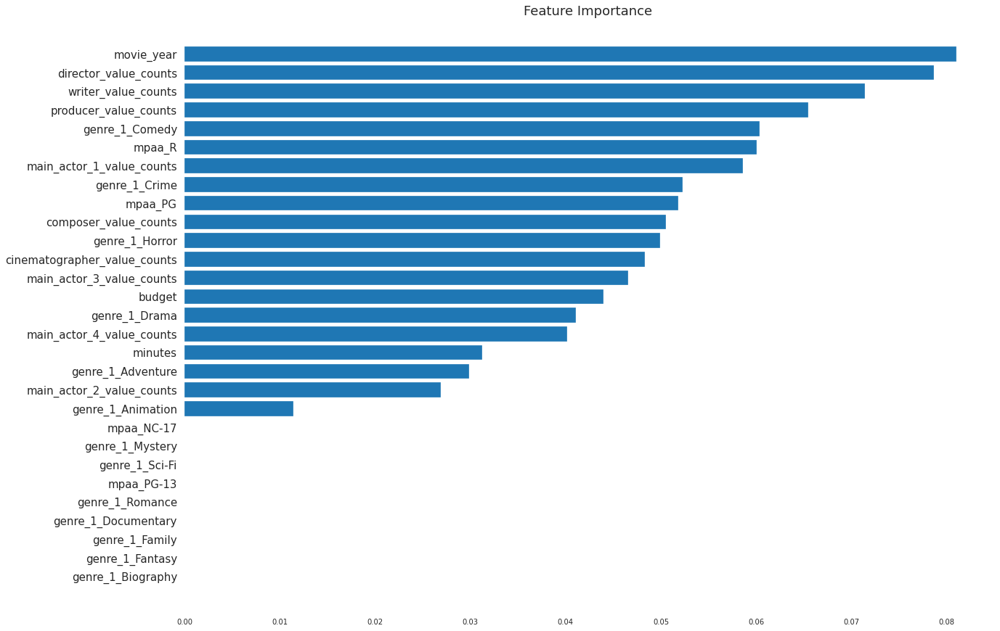

In [98]:
#viz feature importance
feature_importance = grid_search_xgb_model_classificaiton.best_estimator_.feature_importances_
sorted_importance = np.argsort(feature_importance)
pos = np.arange(len(sorted_importance))
plt.figure(figsize=(20,15))
plt.barh(pos, feature_importance[sorted_importance],align='center')
plt.yticks(pos, X_train_rfe.columns[sorted_importance],fontsize=15)
plt.title('Feature Importance ',fontsize=18)
plt.show()